# Practical work on SAR statistics 

### Emanuele DALSASSO, Florence TUPIN

Images of the practical work can be found on: 
https://perso.telecom-paristech.fr/dalsasso/TPSAR/
and 
https://perso.telecom-paristech.fr/tupin/TPSAR/DATA/images/

Some useful functions are available in the file *mvalab.py*. 

The practical work will be organised as follows:
* A. Single look data distribution
* B. Speckle simulation and multiplicative noise model
* C. Image despeckling: simple averaging and Lee filter
* D. Deep Learning based denoising

### First steps
The first three cells will download the *mvalab.py* stript with some useful functions to read the data, import the libraries needed and implement a fuction to visualize SAR images in a more pleasant way, as well as creating synthetic speckle noise.
  

In [ ]:
!wget https://perso.telecom-paristech.fr/dalsasso/TPSAR/mvalab.py
!wget https://perso.telecom-paristech.fr/dalsasso/TPSAR/lely.npy
!wget https://perso.telecom-paristech.fr/dalsasso/TPSAR/pepper.png

--2021-05-19 19:49:06--  https://perso.telecom-paristech.fr/dalsasso/TPSAR/mvalab.py
Resolving perso.telecom-paristech.fr (perso.telecom-paristech.fr)... 137.194.2.165, 2001:660:330f:2::a5
Connecting to perso.telecom-paristech.fr (perso.telecom-paristech.fr)|137.194.2.165|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 68035 (66K) [text/x-python]
Saving to: ‘mvalab.py’

mvalab.py           100%[===================>]  66.44K  --.-KB/s    in 0.01s   

2021-05-19 19:49:06 (4.79 MB/s) - ‘mvalab.py’ saved [68035/68035]

--2021-05-19 19:49:06--  https://perso.telecom-paristech.fr/dalsasso/TPSAR/lely.npy
Resolving perso.telecom-paristech.fr (perso.telecom-paristech.fr)... 137.194.2.165, 2001:660:330f:2::a5
Connecting to perso.telecom-paristech.fr (perso.telecom-paristech.fr)|137.194.2.165|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2000128 (1.9M)
Saving to: ‘lely.npy’

lely.npy            100%[===================>]   1.91M  --.-KB/s    i

In [ ]:
%matplotlib inline
import scipy
from scipy import signal
import scipy.signal
import scipy as spy
import scipy.fftpack
import imageio
from scipy import ndimage
from scipy import special
from scipy import ndimage
import numpy as np
import math
import matplotlib.pyplot as plt
import mvalab as mvalab
from urllib.request import urlopen
import cmath
from bokeh.plotting import figure, output_file, show
from bokeh.plotting import show as showbokeh
from bokeh.io import output_notebook
output_notebook()
from bokeh.colors import Color as bcolor
from bokeh.colors.rgb import RGB


plt.rcParams['figure.figsize'] = [8, 8]
plt.rcParams['figure.max_open_warning'] = 30

In [ ]:
def visusar_colab(im,size_fig=500,title='',threshold=None): #special colab
    liste_couleurs_grises=[]
    for k in range(256):
      liste_couleurs_grises.append(RGB(k,k,k))
    
    '''
    by default: compute mean and std on the image at hand
    if 0: display full dynamic
    else: use the custom value that is provided
    '''
    if threshold == None:
      threshold = np.mean(im)+3*np.std(im)
    elif threshold == 0:
      threshold = np.max(im)
    else:
      threshold=threshold

    def normalise_image_pour_bokeh(X,threshold):
      imt=np.copy(X.copy())
      imt/=threshold
      imt[imt<0]=0
      imt[imt>1]=1

      imt*=255
      imt=imt.astype(np.uint8)
      return imt
    img=normalise_image_pour_bokeh(np.flipud(im),threshold)# np.flipud(np.fliplr(im)))
    title = title + ' : mean = '+str(np.mean(im)) + ' std = '+str(np.std(im))
    p = figure(tooltips=[("x", "$x{int}"), ("y", "$y{int}"), ("value", "@image")],title=title, y_range=[im.shape[0],0], x_range=[0, im.shape[1]],plot_width=size_fig, plot_height=int(size_fig*im.shape[0]/im.shape[1]), match_aspect=True)

    # must give a vector of images
    p.image(image=[img], palette=liste_couleurs_grises,x=0,y=im.shape[0], dw=im.shape[1], dh=im.shape[0],dilate=False)
    showbokeh(p)


def injectspeckle_amplitude(img,L):
    rows = img.shape[0]
    columns = img.shape[1]
    s = np.zeros((rows, columns))
    for k in range(0,L):
        gamma = np.abs( np.random.randn(rows,columns) + np.random.randn(rows,columns)*1j )**2/2
        s = s + gamma
    s_amplitude = np.sqrt(s/L)
    ima_speckle_amplitude = np.multiply(img,s_amplitude)
    return ima_speckle_amplitude

def read_png(filename):
  ima = plt.imread(filename)
  ima = np.array(ima)
  ima = np.sqrt(ima[:,:,0]**2+ima[:,:,1]**2+ima[:,:,2]**2)
  ima = ima / ima.max() * 255
  return ima

## A. Single look data distributions 
In this part, we will use a Single Look Complex (SLC) image and analyze the Probability Density Function (PDF) on a manually selected homogeneous area to verify Goodman's hypothesis.

The image has been acquired by the Sentinel-1 sensor over the Lelystad zone in the Netherlands (flat area with fields crops, water and urban areas). 
Vizualize the amplitude image and interpret it. You may want to have a look to an [optical image](https://goo.gl/maps/JJcYcRjMKj1p6uqW8) of the area

***N.B.***: An amplitude image is given by the modulus of the electro-magnetic field and intensity is the square of the amplitude (proportional to the signal power).  

In [ ]:
pageweb="https://perso.telecom-paristech.fr/dalsasso/TPSAR/pilelely/"
image='Lely.CXF'
im_slc_senti_lely_liste=mvalab.imz2mat(pageweb+image);
im_slc_senti_lely = im_slc_senti_lely_liste[0]
ncol=im_slc_senti_lely_liste[1]
nlig=im_slc_senti_lely_liste[2]

# plot the amplitude image

visusar_colab(np.abs(im_slc_senti_lely),size_fig=500) #- insert code here to display the image

# because the image is big you can display a crop of 1024 x 1024 pixels

visusar_colab(np.abs(im_slc_senti_lely)[:1024,:1024],size_fig=500) # complete

imz2mat : version janvier 2018.  Fichier à ouvrir : https://perso.telecom-paristech.fr/dalsasso/TPSAR/pilelely/Lely.CXF
Nom compatible url
Nom compatible url
Complex float, Fichiers PC
INFO - reading header/dim : https://perso.telecom-paristech.fr/dalsasso/TPSAR/pilelely/Lely.dim
lecture .dim OK -> largeur:3072 hauteur:1024 profondeur:1
Debug 2 4 3072
4 3072 <f


### A.1.: Data distributions for an homogeneous area
- Select a **physically homogeneous** area and compute the distribution of the intensity, amplitude, phase, real part and imaginary part. Some useful functions are:
  - `np.angle`
  - `np.real`
  - `np.imag` 

- Compute the histograms for these variables and draw on the histogram the theoretical curve by computing the mean value $\mu$ and the standard deviation $\sigma$ with the function `scipy.stats.[distribution].fit` by replacing `[distribution]` with the [expected pdf](https://docs.scipy.org/doc/scipy/reference/stats.html) 

- Compute the coefficient of variation $\gamma=\frac{\sigma}{\mu}$ in amplitude and in intensity. 

***N.B.***: The Goodman model is valid only on homogeneous area. That is why it is important to select pixels sharing the same distribution (with the same underlying reflectivity).


In [ ]:
# Select a crop of at least 200 by 200 pixels on a homogeneous area
crop_slc = im_slc_senti_lely[850:1000,0:200] # complete
visusar_colab(np.abs(crop_slc))

# Compute amplitude, intensity, phase, real and imaginary part
amp_senti_lely = np.abs(crop_slc) # complete
int_senti_lely = amp_senti_lely*amp_senti_lely # complete
ph_senti_lely = np.angle(crop_slc) # complete
real_senti_lely = np.real(crop_slc) # complete
imag_senti_lely = np.imag(crop_slc) # complete

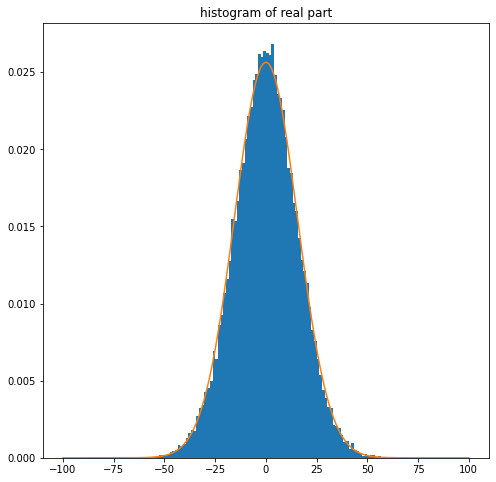

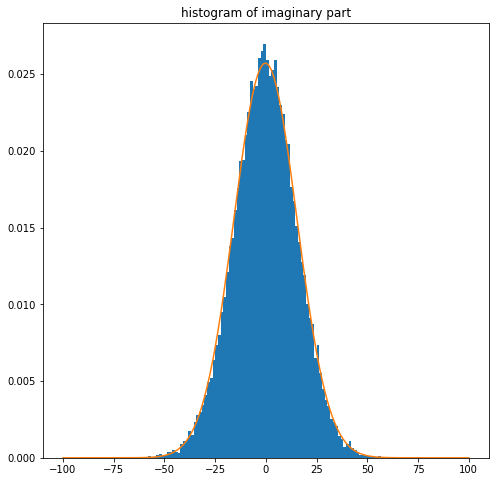

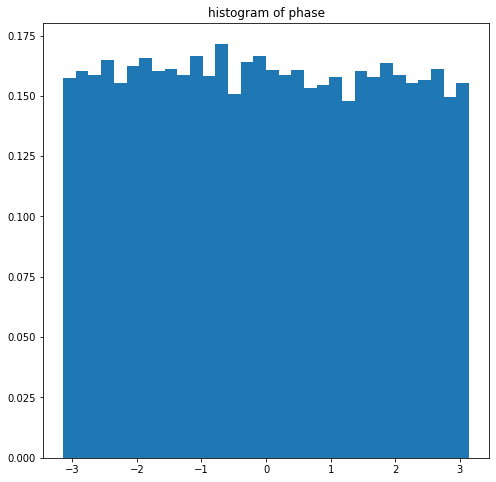

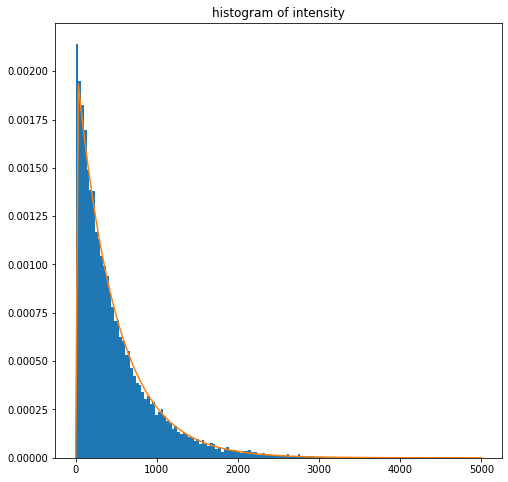

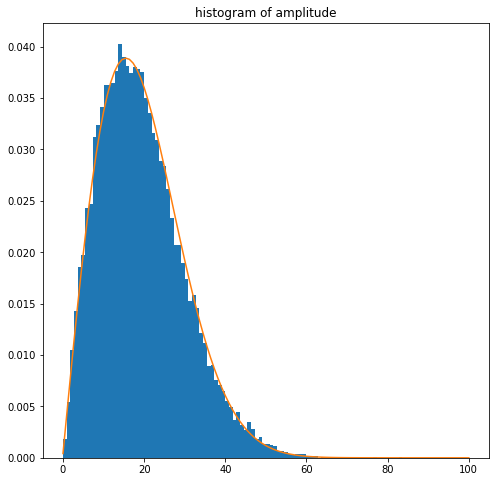

In [ ]:
# Plot the histograms and verify they match the theoretical distribution
plt.rcParams['figure.figsize'] = [8, 8]

# fitting of the distributions 
# use the right one :
# Gaussian pdf : scipy.stats.norm
# Rayleigh pdf : scipy.stats.rayleigh
# Exponential pdf : scipy.stats.expon

#example for real part of the data 
plt.figure()
_, bins, _ = plt.hist(real_senti_lely.ravel(),bins='auto',density=True,range=[-100,100])  # Gaussian distribution
mu, sigma = scipy.stats.norm.fit(real_senti_lely)
best_fit_line = scipy.stats.norm.pdf(bins, mu, sigma) # complete
plt.plot(bins, best_fit_line)
plt.title('histogram of real part')
plt.show()

#complete for imaginary part 
plt.figure()
_, bins, _ = plt.hist(imag_senti_lely.ravel(),bins='auto',density=True,range=[-100,100])  # Gaussian distribution
mu, sigma = scipy.stats.norm.fit(imag_senti_lely)
best_fit_line = scipy.stats.norm.pdf(bins, mu, sigma) # complete
plt.plot(bins, best_fit_line)
plt.title('histogram of imaginary part')
plt.show()


#complete for phase data 
plt.figure()
plt.hist(ph_senti_lely.ravel(),bins='auto',density=True,range=[-np.pi,np.pi])  # Gaussian distribution
plt.title('histogram of phase')
plt.show()


#complete for intensity data 
plt.figure()
_, bins, _ = plt.hist(int_senti_lely.ravel(),bins='auto',density=True,range=[0,5000])  # Gaussian distribution
mu, sigma = scipy.stats.expon.fit(int_senti_lely)
best_fit_line = scipy.stats.expon.pdf(bins, mu, sigma) # complete
plt.plot(bins, best_fit_line)
plt.title('histogram of intensity')
plt.show()

#complete for amplitude data 
plt.figure()
_, bins, _ = plt.hist(amp_senti_lely.ravel(),bins='auto',density=True,range=[0,100])  # Gaussian distribution
mu, sigma = scipy.stats.rayleigh.fit(amp_senti_lely)
best_fit_line = scipy.stats.rayleigh.pdf(bins, mu, sigma) # complete
plt.plot(bins, best_fit_line)
plt.title('histogram of amplitude')
plt.show()

In [ ]:
# Compute the coefficient of variation on the homogeneous crop using intensity data
m_I = np.mean(int_senti_lely) # complete
sigma_I = np.std(int_senti_lely) # complete
coeff_var_I = sigma_I/m_I # complete
print('Coefficient of variation in intensity: '+str(coeff_var_I))

# Compute the coefficient of variation on the homogeneous crop using amplitude data
m_A = np.mean(amp_senti_lely) # complete
sigma_A = np.std(amp_senti_lely) # complete
coeff_var_A = sigma_A/m_A # complete
print('Coefficient of variation in amplitude: '+str(coeff_var_A))

Coefficient of variation in intensity: 1.0535827311258146
Coefficient of variation in amplitude: 0.5401038940453399


### Question A.1.
What are the distributions followed by real part, imaginary part, phase, intensity and amplitude on an homogeneous area ? 
What are the values for the coefficient of variation for amplitude and intensity data? Are they in accordance with the theoretical values ? 

### Answer A.1.
As can be seen in the code above, both normal and imaginary parts follow the normal distribution. The phase follows a uniform distribution (the uniform line wasn’t plotted, but according to what we’ve seen in the class and the results we can confirm that it’s the uniform distribution). The intensity to the exponential, and at last, the amplitude to the Rayleigh.


The value of the coefficient for the amplitude of a homogeneous part should be equal to 1, and for the intensity around 0.5. As we can see above, they are in accordance.


### A.2. Local analysis of the coefficient of variation

The coefficient of variation $\gamma=\frac{\sigma}{\mu}$ (standard deviation normalized by the mean) is an indication of the local homogeneity of the scene. 
It can be computed locally around each pixel using a moving window.

Using 2D convolution (`signal.convolve2d(..,..,mode='same')`) to speed up the processing, compute the image of the coefficient of variation by taking the intensity of `im_slc_senti_lely`. 

### Question A.2.
Comment the results of the image of local coefficient of variation and local standard deviation. 
- Which structures of the image are highlighted with the coefficient of variation ? 
- What is the influence of the window size ? 
- Why is the local standard deviation not adapted to measure the local homogeneity of the scene ?


### Answer A.2.
With the coefficient of variation structures as urban zones/ roads (that are lines) are highlighted. As we increase the window size, the light areas in the variation structures are more contrasting (less noise), but at the same time we lose some information.   At last, the local standard deviation is bigger for lighter parts of the image, as consequence lighter areas will appear as non-homogeneous (for example the fields).  

In [ ]:
#function to compute the coefficient of variation
def compute_coeff_var(ima_int,size_window):
  # create the average window
  mask = np.ones((size_window,size_window),dtype=float)/(size_window**2) # complete

  # compute the mean image E{I}
  ima_int_mean = signal.convolve2d(ima_int, mask,mode='same')

  # compute the variance image (var{I} = E{I^2} - E{I}^2)
  ima_int_square = np.multiply(ima_int,ima_int) # I^2 
  ima_int_mean_square = signal.convolve2d(ima_int_square, mask,mode='same') # complete # E{I^2}
  ima_variance = ima_int_mean_square - ima_int_mean*ima_int_mean # var{I}

  # compute coefficient of variation
  ima_coeff_var = np.sqrt(ima_variance)/(ima_int_mean +0.0000001) # avoid division by 0
  return ima_variance,ima_int_mean, ima_coeff_var

In [ ]:
# take the intensity 
ima_int = np.abs(np.multiply(im_slc_senti_lely, np.conjugate(im_slc_senti_lely)))
visusar_colab(np.sqrt(ima_int))

ima_variance,_, ima_coeff_var = compute_coeff_var(ima_int,10)

# plot the coefficient of variation
visusar_colab(ima_coeff_var,title='Coefficient of variation')

# plot the standard deviation
visusar_colab(np.sqrt(ima_variance), title='Standard deviation',threshold=20000)

## B. Speckle simulation and multiplicative noise model
Speckle phenomenon is a determined by the physics of the ground and is a deterministic process. It is however common to model is as a multiplicative noise. You can use the function `injectspeckle_amplitude(img,L)` to simulate speckle noise with a given number of looks L on an amplitude image.

When processing noisy SAR images, it is often beneficial to move into the log domain. This way, the variance is stabilized (i.e. it becomes homogeneous on the whole image).

Moreover, the distribution approaches a Gaussian distribution as L increases.

### B.1. Edge detection
Create a simulated image by concatenating a dark rectangle with a bright one and simulate speckle noise on it (you can use values of 100 and 150 for the two parts). Use the sobel edge detector to process the amplitude image and the log of the amplitude.

Do the same processing for the image *pepper.png* by reading it in the following way: `ima_pepper = read_png('pepper.png')`.

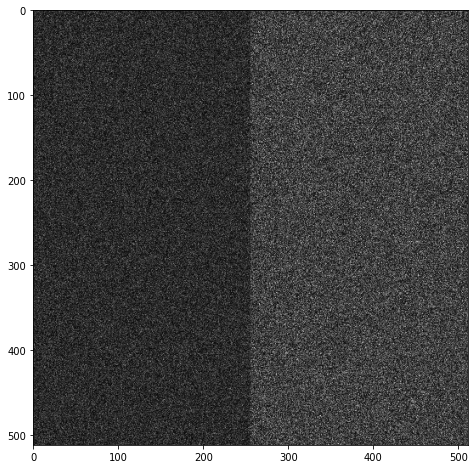

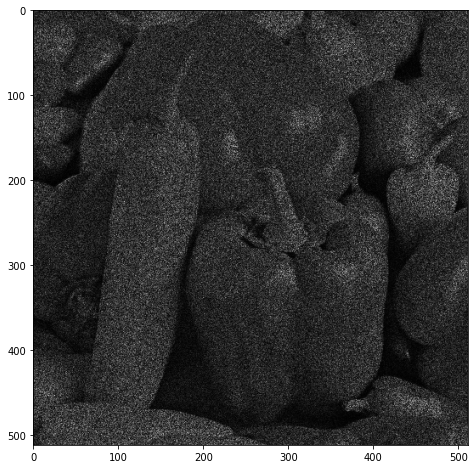

In [ ]:
simu_image = np.concatenate((100*np.ones((512,256)),150*np.ones((512,256))),axis=1) # complete

# use the injectspeckle_amplitude function to create speckle with L=1
simu_speckle = injectspeckle_amplitude(simu_image,1) # complete
plt.figure()
plt.imshow(simu_speckle,cmap='gray')
plt.show()

# use pepper.png image to create a speckled image with L=1
ima_pepper = read_png('pepper.png')  #complete

# plot the image
simu_speckle_pepper = injectspeckle_amplitude(ima_pepper,1) # complete
plt.figure()
plt.imshow(simu_speckle_pepper,cmap='gray')
plt.show() #complete

In [ ]:
def sobel_filters(img):
    Kx = np.array([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]], np.float32)
    Ky = np.array([[1, 2, 1], [0, 0, 0], [-1, -2, -1]], np.float32)
    
    Ix = ndimage.filters.convolve(img, Kx)
    Iy = ndimage.filters.convolve(img, Ky)
    
    G = np.hypot(Ix, Iy)
    G = G / G.max() * 255
    theta = np.arctan2(Iy, Ix)

    return (G, theta)

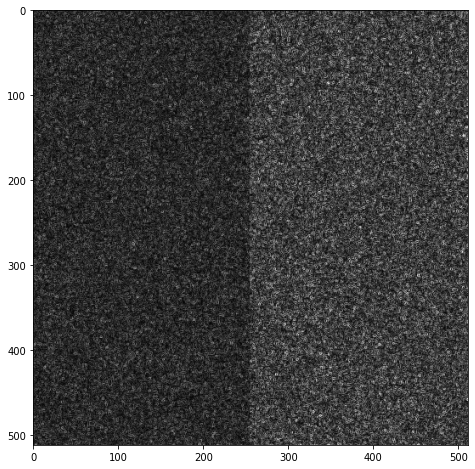

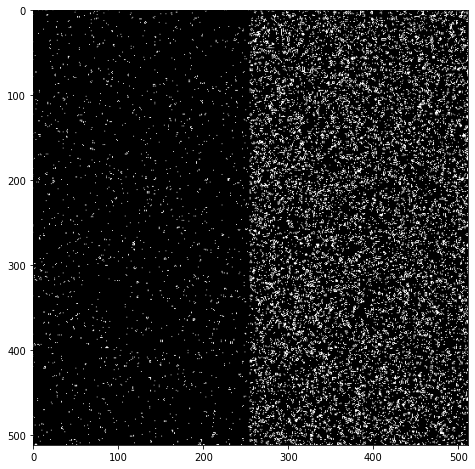

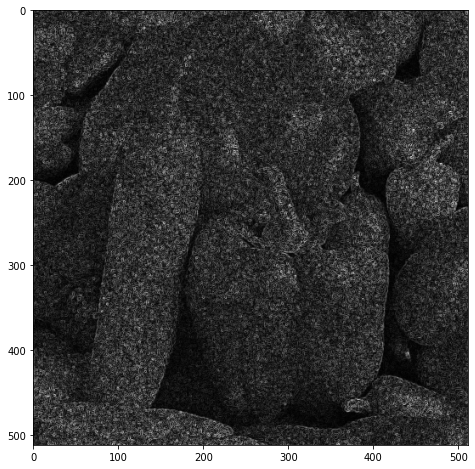

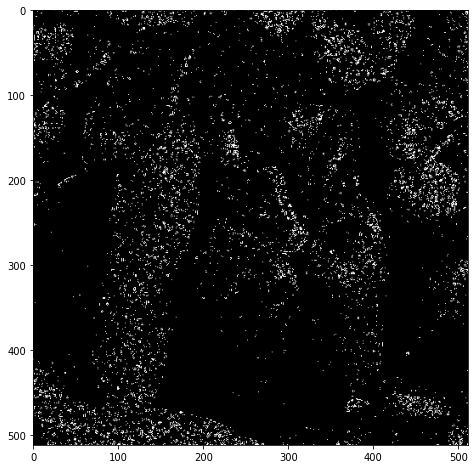

In [ ]:
# apply filters in intensity
edge_n, theta = sobel_filters(simu_speckle) # complete

#display the magnitude of the edge detector
plt.figure()
plt.imshow(edge_n,cmap='gray') # complete
plt.show()

#apply a thresholding by choosing an appropriate value et plot the result
edge_n_thres = edge_n > 100 # thresholding: complete
plt.figure()
plt.imshow(edge_n_thres,cmap='gray') # complete
plt.show()

# do the same operations for pepper
edge_n, theta = sobel_filters(simu_speckle_pepper) # complete

#display the magnitude of the edge detector
plt.figure()
plt.imshow(edge_n,cmap='gray') # complete
plt.show()

#apply a thresholding by choosing an appropriate value et plot the result
edge_n_thres = edge_n > 100 # thresholding: complete
plt.figure()
plt.imshow(edge_n_thres,cmap='gray') # complete
plt.show()


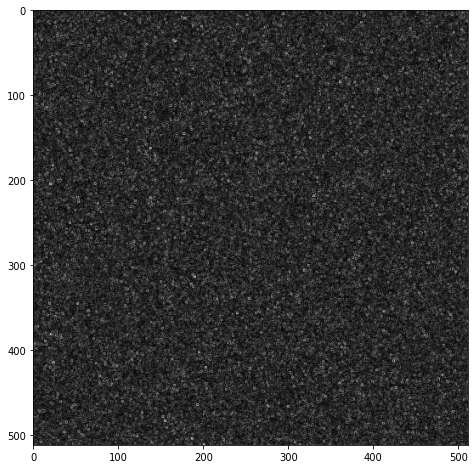

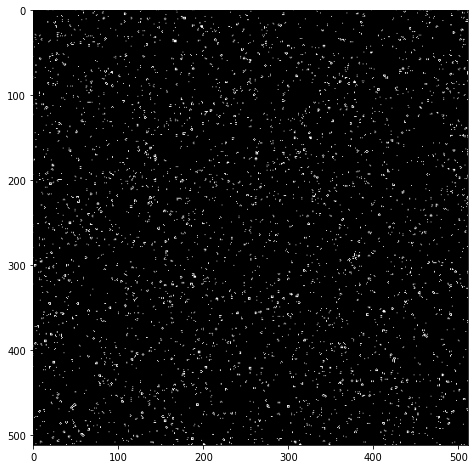

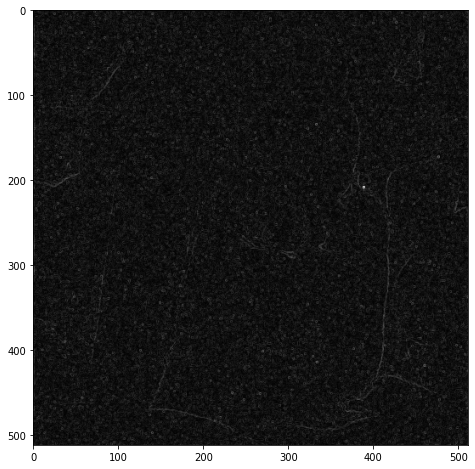

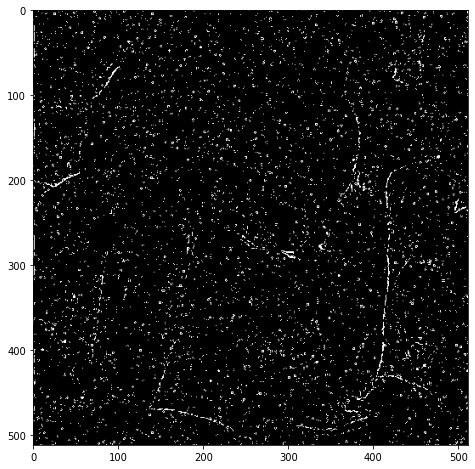

In [ ]:
# apply filters to log-transformed data
edge_n, theta = sobel_filters(np.log(simu_speckle)) # complete

plt.figure()
plt.imshow(edge_n,cmap='gray')
plt.show()

#apply a thresholding by choosing an appropriate value et plot the result
edge_n_thres = edge_n > 100 # thresholding: complete
plt.figure()
plt.imshow(edge_n_thres,cmap='gray') # complete
plt.show()

# do the same operations for pepper
edge_n, theta = sobel_filters(np.log(simu_speckle_pepper+0.0000001)) # complete

#display the magnitude of the edge detector
plt.figure()
plt.imshow(edge_n,cmap='gray') # complete
plt.show()

#apply a thresholding by choosing an appropriate value et plot the result
edge_n_thres = edge_n > 40 # thresholding: complete
plt.figure()
plt.imshow(edge_n_thres,cmap='gray') # complete
plt.show()



### Question B.1. 
Compare the two results (with and without the log-transform). What can you observe? Why do you have more false positives on the amplitude image?

### Answer B.1.
We can observe that without the log, there is a great difference between the false-alarm of the lighter areas and the darker areas.  This is corrected after the log transformation (we can specially see it in the simulated image). For the pepper image, also applying the log transformation is enough for us to see some contours more clearly. 

This happens because the log transforms turn the noise from multiplicative into additive, therefore with similar standard deviation throughout the whole picture.

### Question B.2. 
Discuss the influence of the number of looks L. Can you detect the edges with Sobel filter for L=1 ? What is the minimum value to start detecting the edges ?

###Answer B.2
We can see some contours in the pepper image with L=1, but they aren’t clear. We start to get better results with L=3.

## C. Image despeckling: simple averaging and Lee filter

The local coefficient of variation is also used in a very famous filter for SAR images: the Lee filter. 
The principle of the filter is to combine the pixel value $I_s$ (intensity value of pixel $s$) and the local mean $\hat{\mu}_{s}$ depending on the local coefficient of variation $\hat{\gamma}_s$ with the following formula :
$
  \hat{I}_s= \hat{\mu}_{s}+k_s (I_s-\hat{\mu}_{s})
$

and
$
  k_s=1- \frac{\gamma_{Sp}^2}{\hat{\gamma}_s^2}
$

$\gamma_{Sp}$ is the theoretical value of the coefficient of variation for a pure speckle ($\gamma_{Sp}=\frac{1}{\sqrt{L}}$ for a L-look intensity image).

In this part, we will work both on a noisless image with simulated speckle and on a real image.

### Question C.1.
Using the previously implemented `compute_coeff_var` function, implement the Lee filter and visualize the denoised image. Comment the result and compare it with a local mean. What are the differences ?

Warning : $k$ should be in $[0,1]$.

### Answer C.1.
The results are better than the local-mean, with sharper edges, however still some noise in the middle of homogeneous areas. 

In [ ]:
noiseless = np.load('./lely.npy')
visusar_colab(noiseless)

noisy = injectspeckle_amplitude(noiseless,1)
visusar_colab(noisy,size_fig=500)

In [ ]:
ima_int = np.square(noisy) # take the intensity
_,ima_int_mean, ima_coeff_var = compute_coeff_var(ima_int,7)

# compute ks
ks = 1 - (1 / ima_coeff_var**2) # complete

# force k to have values comprised in the range [0,1]
ks[ks<0]=0
visusar_colab(ks,threshold=0,size_fig=500)

# filter the image
image_lee_filtered = ima_int_mean + np.multiply(ks,ima_int-ima_int_mean) # complete
visusar_colab(np.sqrt(image_lee_filtered),title='Image denoised using Lee filter',size_fig=500)
visusar_colab(np.sqrt(ima_int_mean),title='Image denoised with local averaging',size_fig=500)

### Question C.2.
Apply the same fitering to a real image and comment the result you obtain.

### Answer C.2.
Again, the results are better than the mean (the mean results in a really blurred image), but we have some white areas in the middle of the homogeneous areas, which shouldn’t be there.   

In [ ]:
# Real SLC SAR image
real_noisy_slc = mvalab.imz2mat('https://perso.telecom-paristech.fr/dalsasso/TPSAR/pilelely/multitemp/lely_tuple_multitemp.IMA')
real_noisy_int = np.square(np.abs(real_noisy_slc[0][:,:,0]))
visusar_colab(np.sqrt(real_noisy_int),size_fig=500)


imz2mat : version janvier 2018.  Fichier à ouvrir : https://perso.telecom-paristech.fr/dalsasso/TPSAR/pilelely/multitemp/lely_tuple_multitemp.IMA
Nom compatible url
Nom compatible url
INFO - reading header/dim : https://perso.telecom-paristech.fr/dalsasso/TPSAR/pilelely/multitemp/lely_tuple_multitemp.dim
Multitemporal image 25 data
Fichiers PC
Image  complex float
lecture .dim OK -> largeur:512 hauteur:512 profondeur:25
Debug 2 4 512
4 512 <f


In [ ]:
_,ima_int_mean, ima_coeff_var = compute_coeff_var(real_noisy_int,7)

# compute ks
ks = 1 - (1 / ima_coeff_var**2) # complete

# force k to have values comprised in the range [0,1]
ks[ks<0]=0
visusar_colab(ks,threshold=0,size_fig=500)

# filter the image
image_lee_filtered = ima_int_mean + np.multiply(ks,real_noisy_int-ima_int_mean) # complete
visusar_colab(np.sqrt(image_lee_filtered),title='Image denoised using Lee filter',size_fig=500)
visusar_colab(np.sqrt(ima_int_mean),title='Image denoised with local averaging',size_fig=500)

### Question C.3.
Apply the Lee filter to the synthetic image you have previously created by concatenating a brighter area with a darker one and by corrupting it with a single-look speckle. What is happening in the homogeneous areas ? And around the edge ?

### Answer C.3.

The lighter areas get darker because the homogeneous regions are being averaged. However, the edge is staying the same, resulting in a white line in the transition of homogeneous areas.      

In [ ]:
# Add speckle on the image
simu_image = np.concatenate((15*np.ones((512,256)),150*np.ones((512,256))),axis=1) # complete
simu_speckle = injectspeckle_amplitude(simu_image,1) 

# Apply the Lee filter
_,ima_int_mean, ima_coeff_var = compute_coeff_var(simu_speckle,7)

# compute ks
ks = 1 - (1 / ima_coeff_var**2) # complete

# force k to have values comprised in the range [0,1]
ks[ks<0]=0
visusar_colab(1-(1 / ima_coeff_var**2),threshold=0,size_fig=500)

# Display the result
image_lee_filtered = ima_int_mean + np.multiply(ks,real_noisy_int-ima_int_mean) # complete
visusar_colab(np.sqrt(image_lee_filtered),title='Image denoised using Lee filter',size_fig=500)
visusar_colab(np.sqrt(ima_int_mean),title='Image denoised with local averaging',size_fig=500)


## D: Deep Learning based denoising
Most recent denoising approaches rely on deep neural networks. As you have seen, simulated speckle noise does not perfectly fit the statistics of real SAR images. In particular, the spatial correlation is not modeled by Goodman's model and this is a source of artifacts. 

The **SAR2SAR** algorithm has been trained in a semi-supervised way, learning speckle statistics directly from real images. You can test it on single look images using the notebook `` SAR2SAR_Single_Look_test.ipynb`` that you can find at [this Gitlab repository](https://gitlab.telecom-paris.fr/ring/sar2sar).


### Question D.1.
Comment the main differences with respect to the Lee filter and the mean filter. Have the edges been preserved and the homogeneous areas denoised without creating artifacts?

### Answer D.1.
The results obtained using SAR2SAR were considerable better than the ones obtained using both previous methods. It was able to better denoise the middle of the homogeneous areas (like the mean filter), while keeping sharper edges (like the Lee filter).